In [1]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from matplotlib.dates import MinuteLocator, SecondLocator, DateFormatter
import pathlib

In [2]:
start_timestamp = 1640502848.1570923339843750
# The FIR filters are a 943 tap filter running at 3.84 Msps input rate
# and a 2049 tap filter running at 10 ksps input rate.
filter_delay = (943-1)/2/3.84e6 + (2409-1)/2/10e3
fs = 100

In [3]:
def process_filterbank(path, nfft=32, pad_start=0,
                       skip_start=0, length_limit=None):
    x = np.fromfile(path, 'complex64')
    w = np.blackman(nfft)
    x = x[skip_start:]
    x = np.pad(x, (pad_start, 0))
    if length_limit is not None:
        x = x[:length_limit]
    x = x[:x.size//nfft*nfft].reshape(-1, nfft)
    f = np.fft.fftshift(np.abs(np.fft.fft(w * x))**2,
                        axes=1)
    return f

In [4]:
path = pathlib.Path('ATA_2021-12-26_seq_ranging/')
filterbank = list(path.glob('seq*.c64'))
data = {f.name.replace('.c64', '').replace('seq', ''):
        process_filterbank(f, length_limit=60*fs*2,
                           skip_start=60*fs-round(fs*((start_timestamp-filter_delay)%60)))
        for f in filterbank}
start_change = 12100
end_change = 13400
data_change = {
    f.name.replace('.c64', '').replace('seq', ''):
    process_filterbank(f, length_limit=(end_change-start_change)*fs,
                       skip_start=start_change*fs)
    for f in filterbank}
data_10sps = {f.name.replace('.c64', '').replace('seq', ''):
              process_filterbank(f, nfft=10, pad_start=round(fs*((start_timestamp-filter_delay)%60)))
              for f in filterbank}

In [5]:
clock_component = 4
last_component = 17
num_freqs = (last_component - clock_component) * 2 + 1
freqs = (
    [f'{j}u' for j in range(clock_component+1, last_component+1)]
    + [f'{clock_component}']
    + [f'{j}l' for j in range(last_component, clock_component, -1)])

In [6]:
t0 = np.datetime64('1970-01-01') + (start_timestamp*1e9)*np.timedelta64(1, 'ns')
t0

numpy.datetime64('2021-12-26T07:14:08.157092352')

<ipython-input-7-ec2aa96cf130>:18: UserWarning: FixedFormatter should only be used together with FixedLocator
  axs[-1].set_xticklabels(axs[-1].get_xticklabels(), rotation=90)


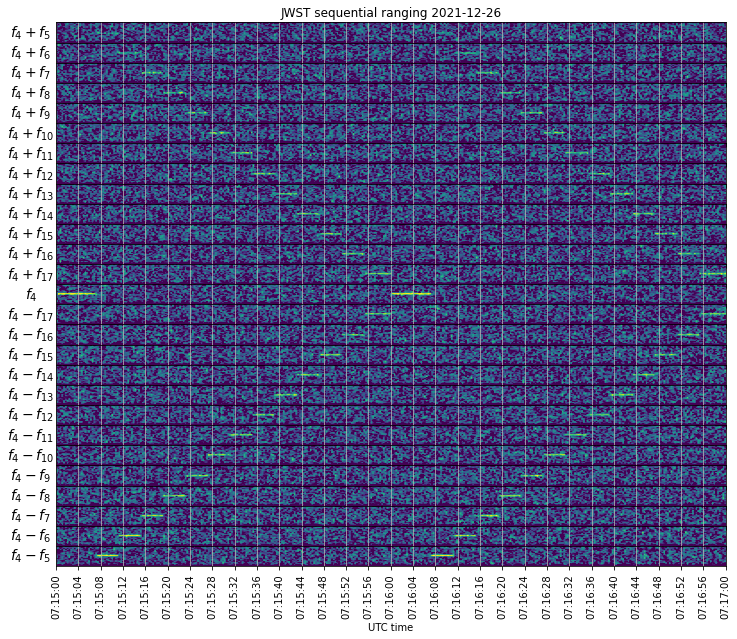

In [7]:
t_start = np.datetime64('2021-12-26T07:15:00')
t_end = t_start + (data['4'].size/fs*1e9)*np.timedelta64(1, 'ns')
fig, axs = plt.subplots(num_freqs, figsize=(12, 10), facecolor='w', sharex=True)
for j, ax in enumerate(axs):
    ax.imshow(10*np.log10(data[freqs[j]].T[::-1]),
              aspect='auto', vmin=-35, vmax=-15,
              extent=[mdates.date2num(t_start), mdates.date2num(t_end), 0, 1])
    if freqs[j][-1] == 'u':
        freq = f'$f_{{{clock_component}}} + f_{{{freqs[j][:-1]}}}$'
    elif freqs[j][-1] == 'l':
        freq = f'$f_{{{clock_component}}} - f_{{{freqs[j][:-1]}}}$'
    else:
        freq = f'$f_{{{freqs[j]}}}$'
    ax.set_yticks([])
    ax.set_ylabel(freq, rotation=0, labelpad=25, fontsize='14', va='center')
    ax.grid()
fig.subplots_adjust(hspace=0)
axs[-1].set_xticklabels(axs[-1].get_xticklabels(), rotation=90)
axs[-1].xaxis.set_major_locator(SecondLocator(interval=4))
axs[-1].xaxis.set_major_formatter(DateFormatter('%H:%M:%S'))
axs[-1].set_xlabel('UTC time')
axs[0].set_title('JWST sequential ranging 2021-12-26');

<ipython-input-8-d411611342cb>:18: UserWarning: FixedFormatter should only be used together with FixedLocator
  axs[-1].set_xticklabels(axs[-1].get_xticklabels(), rotation=45)


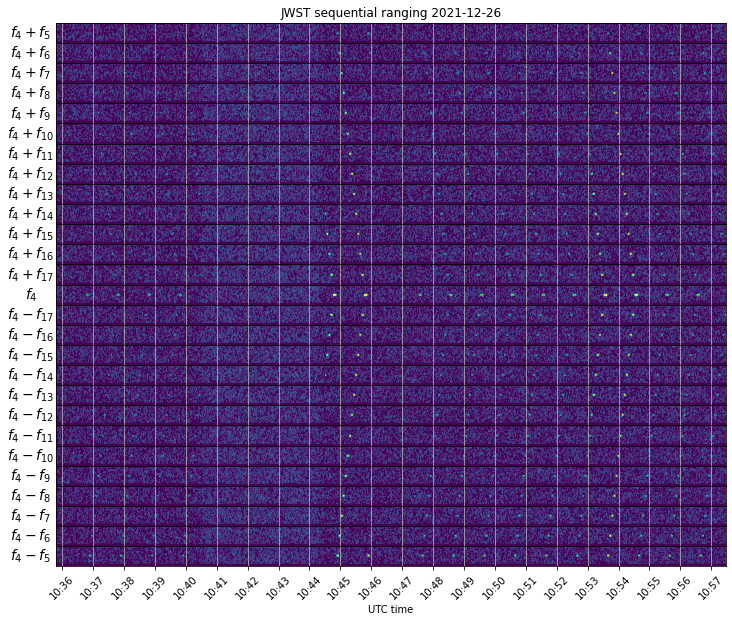

In [8]:
t_start = t0 + ((-filter_delay + start_change)*1e9)*np.timedelta64(1, 'ns')
t_end = t_start + (data_change['4'].size/fs*1e9)*np.timedelta64(1, 'ns')
fig, axs = plt.subplots(num_freqs, figsize=(12, 10), facecolor='w', sharex=True)
for j, ax in enumerate(axs):
    ax.imshow(10*np.log10(data_change[freqs[j]].T[::-1]),
              aspect='auto', vmin=-35, vmax=-15,
              extent=[mdates.date2num(t_start), mdates.date2num(t_end), 0, 1])
    if freqs[j][-1] == 'u':
        freq = f'$f_{{{clock_component}}} + f_{{{freqs[j][:-1]}}}$'
    elif freqs[j][-1] == 'l':
        freq = f'$f_{{{clock_component}}} - f_{{{freqs[j][:-1]}}}$'
    else:
        freq = f'$f_{{{freqs[j]}}}$'
    ax.set_yticks([])
    ax.set_ylabel(freq, rotation=0, labelpad=25, fontsize='14', va='center')
    ax.grid()
fig.subplots_adjust(hspace=0)
axs[-1].set_xticklabels(axs[-1].get_xticklabels(), rotation=45)
axs[-1].xaxis.set_major_locator(MinuteLocator())
axs[-1].xaxis.set_major_formatter(DateFormatter('%H:%M'))
axs[-1].set_xlabel('UTC time')
axs[0].set_title('JWST sequential ranging 2021-12-26');

In [9]:
def reshape_minute(x):
    bins = x.shape[-1]
    d = np.zeros((int(np.ceil(x.shape[0]/600))*600, bins))
    d[:x.shape[0]] = x
    d = d.reshape(-1, 600, bins)
    return d

In [10]:
def plot_raster(key, title, **kwargs):
    t_start = np.datetime64('2021-12-26T07:14:00')
    t_end = t_start + reshape_minute(data_10sps[key]).shape[0]*np.timedelta64(1, 'm')
    plt.figure(figsize=(12, 6), facecolor='w')
    plt.imshow(10*np.log10(np.sum(reshape_minute(data_10sps[key][:, 5-1:5+2]), axis=-1)),
               aspect='auto', vmin=-35, vmax=-20,
               extent=[0, 60, mdates.date2num(t_end), mdates.date2num(t_start)],
               **kwargs)
    plt.xticks(np.arange(0, 61, 2))
    plt.grid()
    plt.gca().yaxis.set_major_locator(MinuteLocator(byminute=range(0, 60, 10)))
    plt.gca().yaxis.set_major_formatter(DateFormatter('%H:%M'))
    plt.ylabel('UTC time')
    plt.xlabel('Second in minute')
    plt.title(f'JWST sequential ranging: {title}')

In [11]:
def avg_pwr(key):
    z = np.average(np.sum(reshape_minute(data_10sps[key][:, 5-1:5+2])[:60], axis=-1), axis=0)
    mask = np.abs(np.arange(z.size) - 82) <= 3
    z = z[~mask]
    zmax = np.max(z)
    zavg = np.average(z[z >= 0.8*zmax])
    return zavg

avg_pwrs = {k: avg_pwr(k) for k in data_10sps.keys()}
def freq(key):
    downlink_freq = 2270.5e6
    f0 = downlink_freq * 221/240 * 2**-7
    chop = f0 * 2**-4
    if key[-1] == 'u':
        return chop + f0 * 2**-int(key[:-1])
    elif key[-1] == 'l':
        return chop - f0 * 2**-int(key[:-1])
    else:
        return f0 * 2**-int(key)

<ipython-input-10-114a80404358>:5: RuntimeWarning: divide by zero encountered in log10
  plt.imshow(10*np.log10(np.sum(reshape_minute(data_10sps[key][:, 5-1:5+2]), axis=-1)),
<ipython-input-10-114a80404358>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(12, 6), facecolor='w')


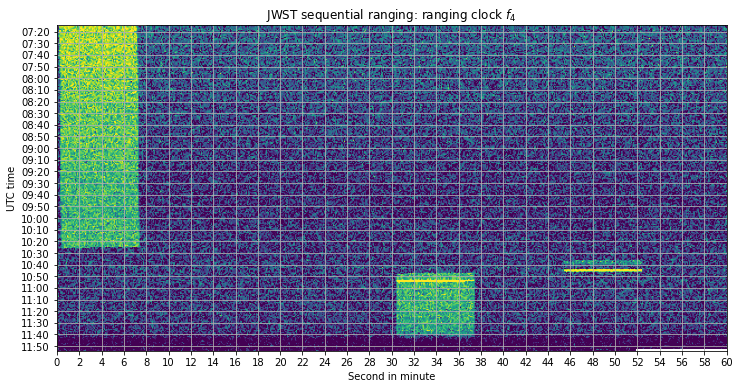

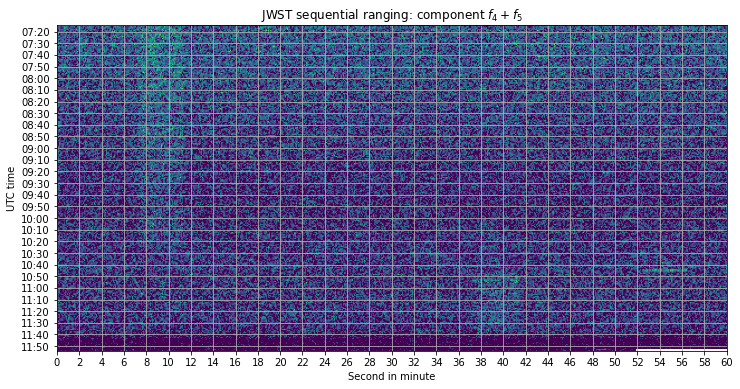

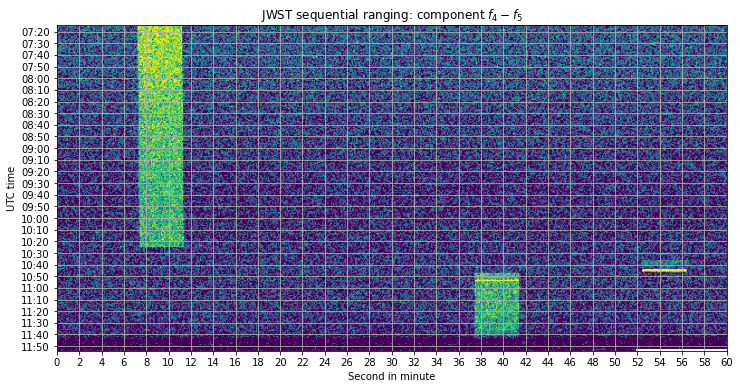

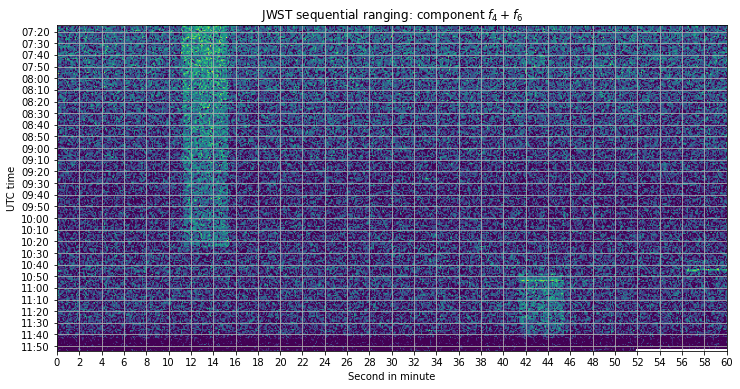

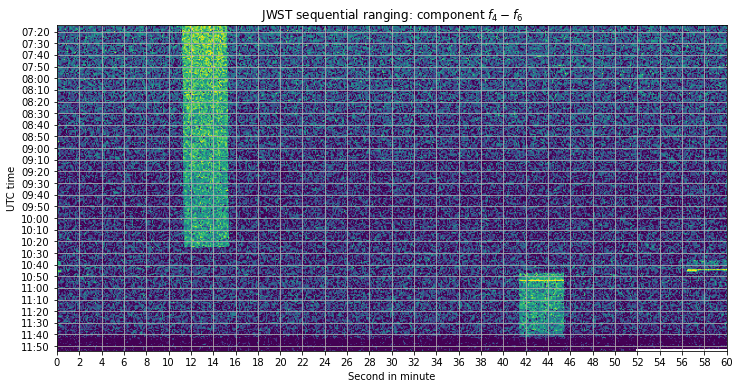

...

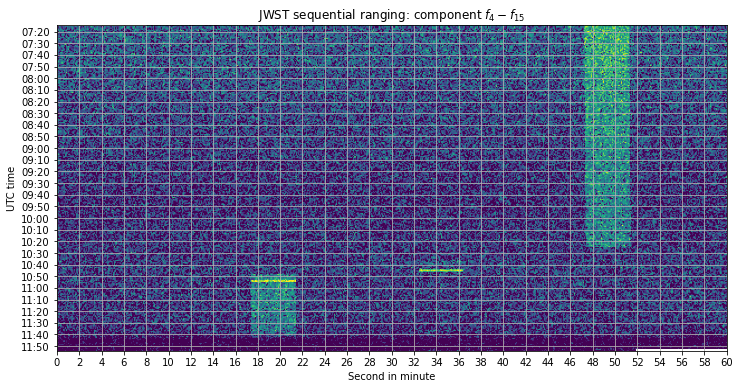

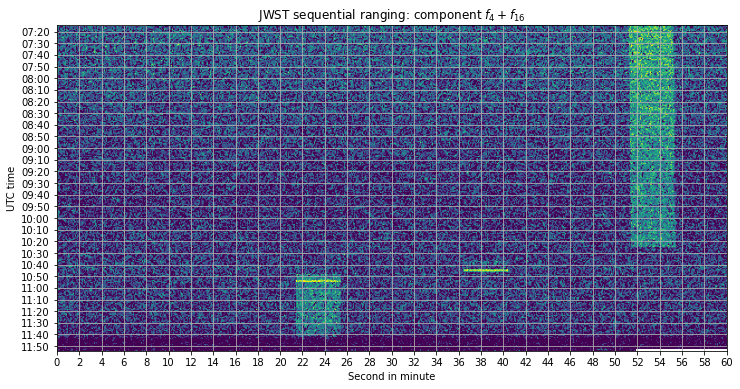

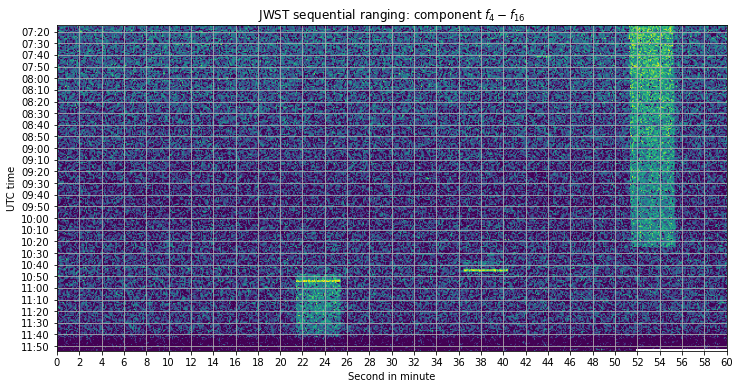

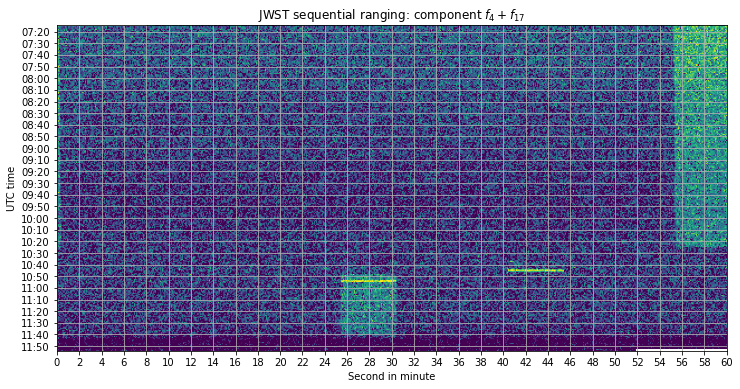

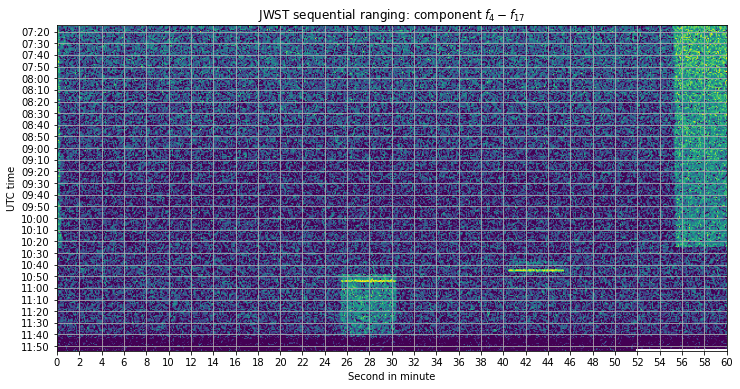

In [12]:
plot_raster('4', 'ranging clock $f_4$')
for j in range(5, last_component+1):
    plot_raster(f'{j}u', f'component $f_4+f_{{{j}}}$')
    plot_raster(f'{j}l', f'component $f_4-f_{{{j}}}$')

<ipython-input-10-114a80404358>:5: RuntimeWarning: divide by zero encountered in log10
  plt.imshow(10*np.log10(np.sum(reshape_minute(data_10sps[key][:, 5-1:5+2]), axis=-1)),


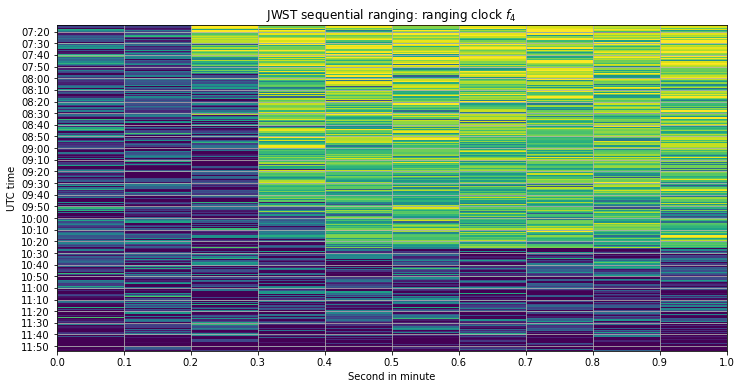

In [13]:
plot_raster('4', 'ranging clock $f_4$', interpolation='none')
plt.xlim((0, 1))
plt.xticks(np.arange(0, 1.1, 0.1));

<ipython-input-10-114a80404358>:5: RuntimeWarning: divide by zero encountered in log10
  plt.imshow(10*np.log10(np.sum(reshape_minute(data_10sps[key][:, 5-1:5+2]), axis=-1)),


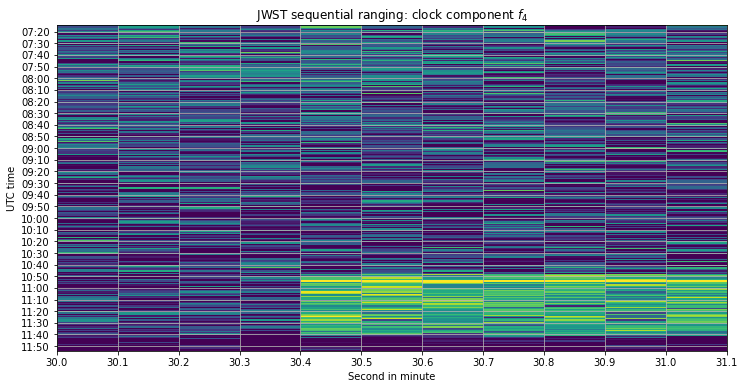

In [14]:
plot_raster('4', 'clock component $f_4$', interpolation='none')
plt.xlim((30, 31))
plt.xticks(np.arange(30, 31.1, 0.1));

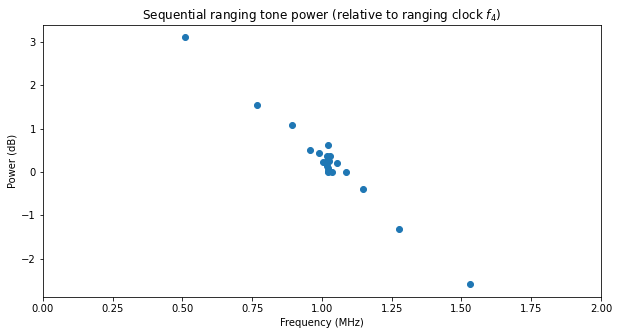

In [15]:
plt.figure(figsize=(10, 5), facecolor='w')
for k in data_10sps.keys():
    mult = 2 if k[-1] in 'ul' else 1
    plt.plot([freq(k)*1e-6], 10*np.log10(mult*avg_pwrs[k]/avg_pwrs['4']), 'o', color='C0')
plt.xlim((0, 2))
plt.title('Sequential ranging tone power (relative to ranging clock $f_4$)')
plt.ylabel('Power (dB)')
plt.xlabel('Frequency (MHz)');